In [8]:
import pandas as pd
df = pd.read_csv('../data/togo-dapaong_qc.csv')
df.head()
df.describe()
df.isna().sum()

GHI                   0
DNI                   0
DHI                   0
ModA                  0
ModB                  0
Tamb                  0
RH                    0
WS                    0
WSgust                0
WSstdev               0
WD                    0
WDstdev               0
BP                    0
Cleaning              0
Precipitation         0
TModA                 0
TModB                 0
Comments         525600
dtype: int64

In [9]:
from scipy.stats import zscore
import numpy as np

cols = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']
z_scores = np.abs(zscore(df[cols]))
outliers = (z_scores > 3).any(axis=1)
df[outliers]
for col in cols:
    df[col].fillna(df[col].median(), inplace=True)


C:\Users\PC\AppData\Local\Temp\ipykernel_22200\3430211991.py:9: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].median(), inplace=True)


In [10]:
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df.set_index('Timestamp', inplace=True)

KeyError: 'Timestamp'

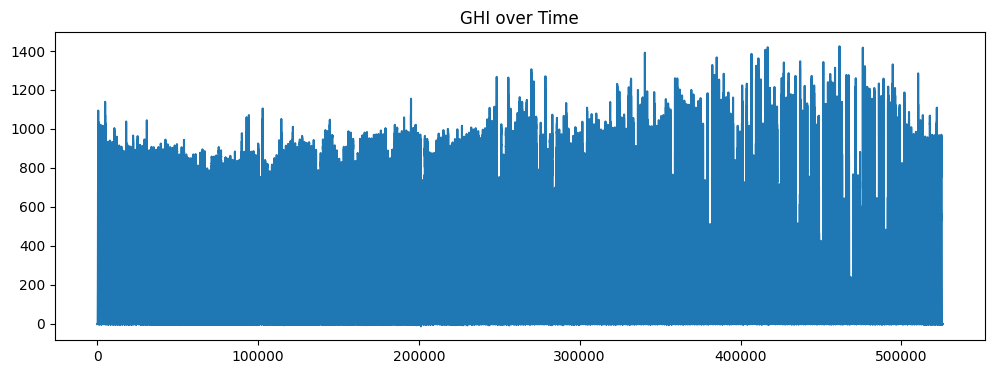

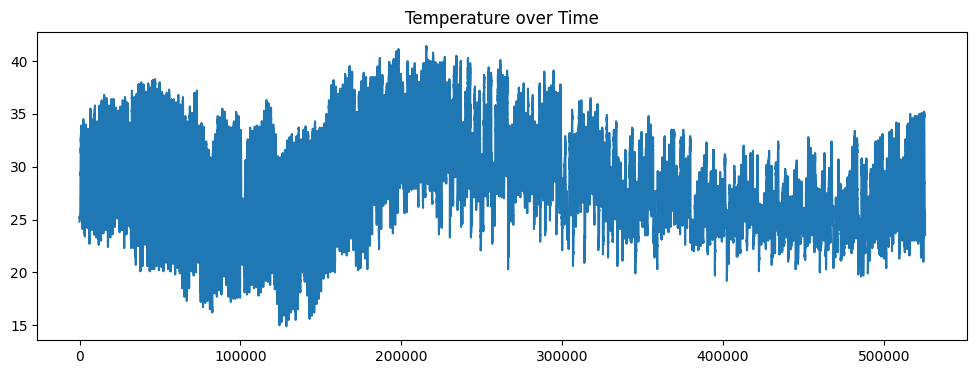

In [11]:
import matplotlib.pyplot as plt

df['GHI'].plot(title='GHI over Time', figsize=(12,4))
plt.show()

df['Tamb'].plot(title='Temperature over Time', figsize=(12,4))
plt.show()


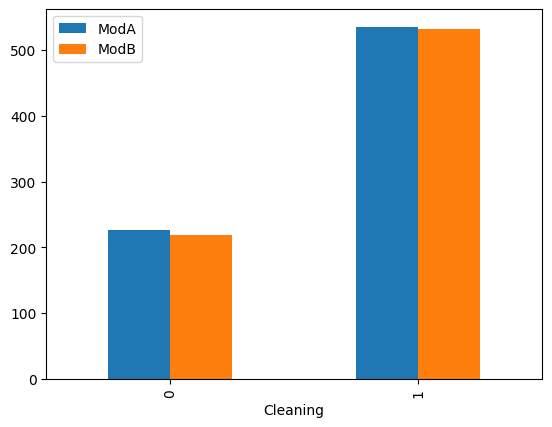

In [12]:
df.groupby('Cleaning')[['ModA','ModB']].mean().plot(kind='bar')
plt.show()

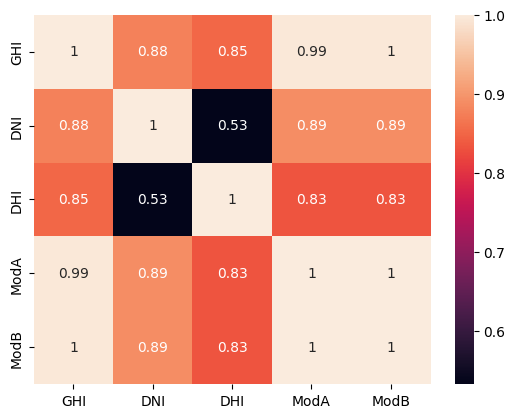

<Axes: xlabel='WS', ylabel='GHI'>

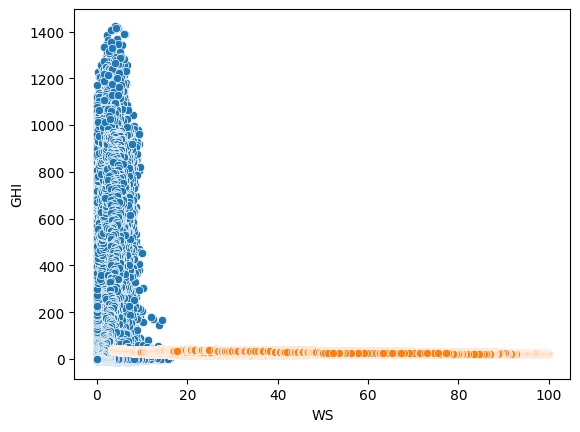

In [13]:
import seaborn as sns

sns.heatmap(df[['GHI','DNI','DHI','ModA','ModB']].corr(), annot=True)
plt.show()

sns.scatterplot(x='WS', y='GHI', data=df)
sns.scatterplot(x='RH', y='Tamb', data=df)


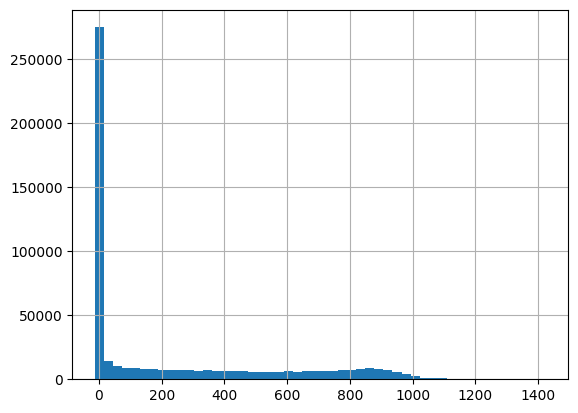

In [14]:
df['GHI'].hist(bins=50)
plt.show()

In [15]:
import plotly.express as px
fig = px.scatter_polar(df, r='WS', theta='WD', color='WS', title='Wind Rose')
fig.show()


<Axes: xlabel='RH', ylabel='Tamb'>

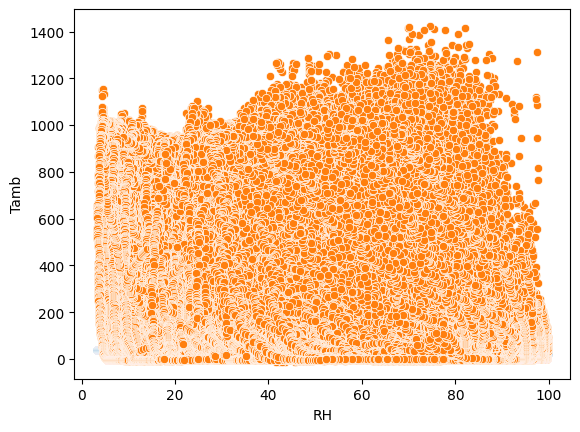

In [16]:
sns.scatterplot(x='RH', y='Tamb', data=df)
sns.scatterplot(x='RH', y='GHI', data=df)


In [17]:
fig = px.scatter(df, x='Tamb', y='GHI', size='RH', color='RH',title='GHI vs Temperature with Humidity')
fig.show()

In [ ]:
df.to_csv('../data/togo_clean.csv', index=False)